In [1]:
import numpy as np
import matplotlib.pyplot as plt

1. Consider $ P(x) = x^3 + 3x^2 - x - 3$ on $[-3, 1]$

In [2]:
def polynom(x):
    return x ** 3 + 3 * x ** 2 - x - 3

In [3]:
X = np.linspace(-3, 1)
Y = polynom(X)

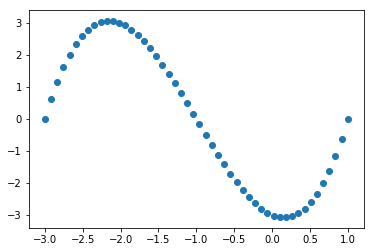

In [4]:
plt.scatter(X, Y)
plt.show()

2. Random sample points of $P(x)$ on two subsets: $[-3, 0]$ and $[-2, 1]$

In [5]:
left_x = np.random.uniform(-3, 0, 100)
right_x = np.random.uniform(-2, 1, 100)

In [6]:
left_y = polynom(left_x)
right_y = polynom(right_x)

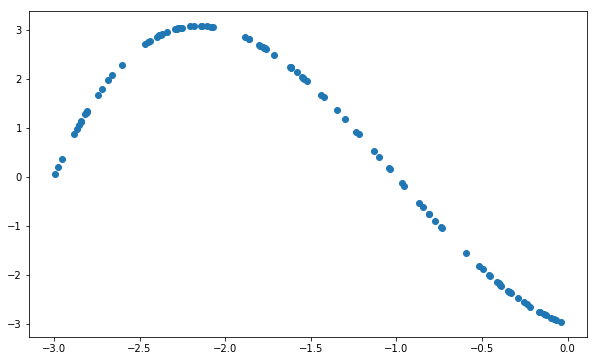

In [7]:
plt.figure(figsize=(10, 6))
plt.scatter(left_x, left_y)
plt.show()

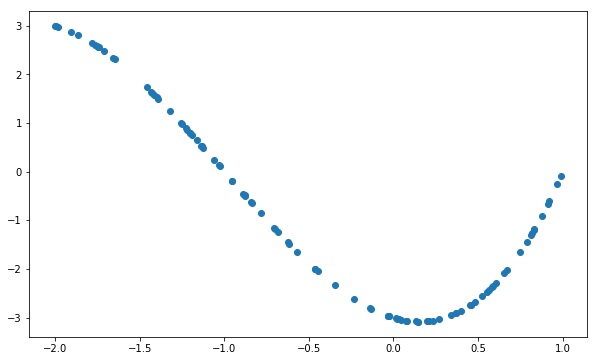

In [8]:
plt.figure(figsize=(10, 6))
plt.scatter(right_x, right_y)
plt.show()

3. Make random translation and rotation of point clouds.

In [9]:
def make_cloud(x, y):
    return np.vstack((x, y)).T

def transform(cloud):
    # Translation
    offset_x = np.random.uniform(-10, 10)
    offset_y = np.random.uniform(-10, 10)
    
    translation_vector = np.array([offset_x, offset_y])
    cloud = cloud + translation_vector
    
    # Rotation
    theta = np.pi / 4 # or random: np.random.uniform(0, 360) / 180 * np.pi
    rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                [np.sin(theta), np.cos(theta)]])
    cloud = (rotation_matrix @ cloud.T).T
    
    return cloud

In [10]:
left_cloud = make_cloud(left_x, left_y)
right_cloud = make_cloud(right_x, right_y)
transformed_right_cloud = transform(right_cloud)

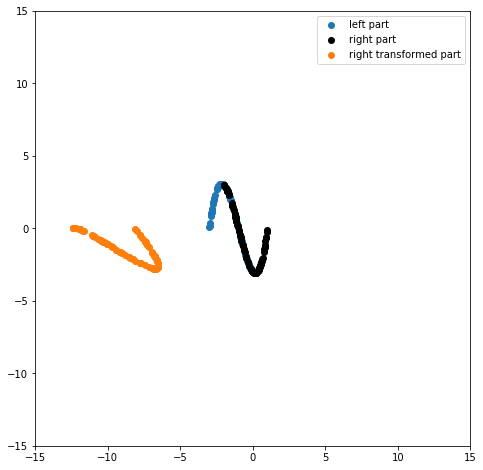

In [13]:
plt.figure(figsize=(8, 8))

plt.scatter(left_cloud[:, 0], left_cloud[:, 1], label="left part")
plt.scatter(right_cloud[:, 0], right_cloud[:, 1], label="right part", color='k')
plt.scatter(transformed_right_cloud[:, 0], transformed_right_cloud[:, 1], label="right transformed part")
plt.legend()
plt.xlim(-15, 15)
plt.ylim(-15, 15)
plt.gca().set_aspect('equal', adjustable='box')

In [14]:
def polynom(polynoms, index, x):
    return polynoms[index][0] * x ** 3 + polynoms[index][1] * x ** 2 + polynoms[index][2] * x + polynoms[index][3]

def make_cloud(x, y):
    return np.vstack((x, y)).T

def transform(cloud):
    # Translation
    offset_x = np.random.uniform(-5, 5)
    offset_y = np.random.uniform(-5, 5)
    
    translation_vector = np.array([offset_x, offset_y])
    cloud = cloud + translation_vector
    
    # Rotation
    theta = np.random.uniform(0, 360) / 180 * np.pi
    rotation_matrix = np.array([[np.cos(theta), -np.sin(theta)],
                                [np.sin(theta), np.cos(theta)]])
    cloud = (rotation_matrix @ cloud.T).T
    
    return cloud, translation_vector, theta

def prepare_dataset(n_samples=150000):
    polynoms = np.random.randint(-10, 10, (n_samples, 4))
    
    left_clouds = []
    transformed_right_clouds = []
    translations = []
    thetas = []
    right_clouds = []
    
    for index in range(n_samples):
        a = np.random.uniform(-1, 0)
        b = a + np.random.uniform(1, 3)
        c = b + np.random.uniform(1, 3)
        d = c + np.random.uniform(1, 3)
        
        left_x = np.random.uniform(a, c, 200)
        right_x = np.random.uniform(b, d, 200)
    
        left_y = polynom(polynoms, index, left_x)
        right_y = polynom(polynoms, index, right_x)

        left_cloud = make_cloud(left_x, left_y)
        right_cloud = make_cloud(right_x, right_y)
    
        transformed_right_cloud, translation, theta = transform(right_cloud)
        
        left_clouds.append(left_cloud)
        transformed_right_clouds.append(transformed_right_cloud)
        translations.append(translation)
        thetas.append(theta)
        right_clouds.append(right_cloud)
    
    return left_clouds, transformed_right_clouds, right_clouds, translations, thetas

In [15]:
left_clouds, transformed_right_clouds, right_clouds, translations, thetas = prepare_dataset()

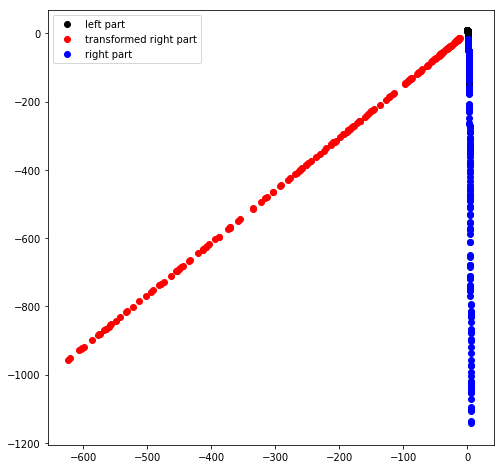

In [16]:
plt.figure(figsize=(8, 8))

plt.scatter(left_clouds[0][:, 0], left_clouds[0][:, 1], label="left part", color='k')
plt.scatter(transformed_right_clouds[0][:, 0], transformed_right_clouds[0][:, 1], label="transformed right part", color='r')
plt.scatter(right_clouds[0][:, 0], right_clouds[0][:, 1], label="right part", color='b')

plt.legend()

In [20]:
from keras.layers import Input, Conv1D

Using TensorFlow backend.


In [21]:
from keras.models import Model

In [22]:
import keras.backend as K
from keras.layers import Conv2DTranspose, Lambda, Reshape, Concatenate

In [148]:
input_3

<tf.Tensor 'input_100:0' shape=(?, 3, 1) dtype=float32>

In [156]:
angles = Concatenate(axis=-1)([input_3]*25)

In [157]:
angles

<tf.Tensor 'concatenate_15/concat:0' shape=(?, 3, 25) dtype=float32>

In [159]:
Reshape((25,3,))(angles)


<tf.Tensor 'reshape_16/Reshape:0' shape=(?, 25, 3) dtype=float32>

In [7]:
merged

<tf.Tensor 'concatenate_2/concat:0' shape=(?, 25, 35) dtype=float32>

In [6]:
angles

<tf.Tensor 'reshape_1/Reshape:0' shape=(?, 25, 3) dtype=float32>

In [23]:
input_1 = Input(shape=(200,2 ), dtype='float32')
input_2 = Input(shape=(200,2 ), dtype='float32')
input_3 = Input(shape=(3,1 ), dtype='float32')


conv1 = Conv1D(4, kernel_size=2, padding='valid', strides=2)(input_1)
conv2 = Conv1D(8, kernel_size=2, padding='valid', strides=2)(conv1)
conv3 = Conv1D(16, kernel_size=2, padding='valid', strides=2)(conv2)

conv1_to = Conv1D(4, kernel_size=2, padding='valid', strides=2)(input_2)
conv2_to = Conv1D(8, kernel_size=2, padding='valid', strides=2)(conv1_to)
conv3_to = Conv1D(16, kernel_size=2, padding='valid', strides=2)(conv2_to)

angles = Concatenate(axis=-1)([input_3]*25)
angles = Reshape((25,3,))(angles)

merged = Concatenate(axis=-1)([conv3, conv3_to, angles])


x = Lambda(lambda x: K.expand_dims(x, axis=2))(merged)
up1 = Conv2DTranspose(filters=8, kernel_size=(10, 1), strides=(2, 1), padding='same')(x)
up2 = Conv2DTranspose(filters=4, kernel_size=(10, 1), strides=(2, 1), padding='same')(up1)
up3 = Conv2DTranspose(filters=2, kernel_size=(10, 1), strides=(2, 1), padding='same')(up2)

up3 = Reshape((200, 2, ))(up3)



# conv1 = Conv1D(128, kernel_size=2)(input_1)
# conv1 = Conv1D(128, kernel_size=2)(input_1)



# merged = concatenate([x1, x2])

# merged = Dense(100, activation='relu')(merged)
# merged = BatchNormalization()(merged)

# merged = Dropout(0.1)(merged)
# preds = Dense(1, activation='sigmoid')(merged)


model = Model(inputs=[input_1,input_2, input_3 ], \
    outputs=up3)
model.compile(loss='mean_squared_error',
    optimizer='adam')

# model_checkpoint = ModelCheckpoint('best_.h5', save_best_only=True, save_weights_only=True)

# model.load_weights('best.h5')



Instructions for updating:
Colocations handled automatically by placer.


In [48]:
merged

<tf.Tensor 'concatenate_4/concat:0' shape=(?, 25, 35) dtype=float32>

In [46]:
conv3

<tf.Tensor 'conv1d_9/add:0' shape=(?, 25, 16) dtype=float32>

In [47]:
conv3_to

<tf.Tensor 'conv1d_12/add:0' shape=(?, 25, 16) dtype=float32>

In [121]:
merged

<tf.Tensor 'concatenate_7/concat:0' shape=(?, 25, 32) dtype=float32>

In [24]:
pred = model.predict([left_clouds[:10], transformed_right_clouds[:10]])

ValueError: Error when checking model input: the list of Numpy arrays that you are passing to your model is not the size the model expected. Expected to see 3 array(s), but instead got the following list of 2 arrays: [array([[[ 2.98945999e-01,  7.04505294e+00],
        [ 7.77786299e-02,  8.64418626e+00],
        [ 7.67702841e-01, -4.58681024e-01],
        ...,
        [ 2.68906219e+00, -1.49597427e+02],
        [ ...

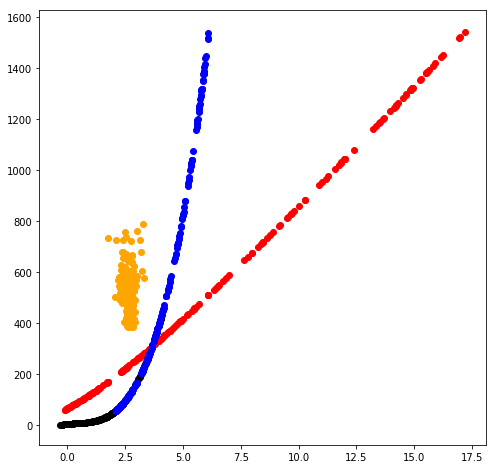

In [143]:
plt.figure(figsize=(8, 8))

plt.scatter(left_clouds[0][:, 0], left_clouds[0][:, 1], label="left part", color='k')
plt.scatter(transformed_right_clouds[0][:, 0], transformed_right_clouds[0][:, 1], label="left part", color='r')
plt.scatter(right_clouds[0][:, 0], right_clouds[0][:, 1], label="left part", color='b')
plt.scatter(pred[0][:, 0], pred[0][:, 1], label="left part", color='orange')


In [25]:
ang = np.concatenate([np.array(translations), np.expand_dims(np.array(thetas), axis=1)], axis=1)

In [26]:
np.vstack([np.expand_dims(thetas, axis=1), np.array(translations)])

ValueError: all the input array dimensions except for the concatenation axis must match exactly

In [27]:
thetas

[5.7033337671952165,
 1.2820136433677638,
 5.771773978979602,
 5.910899407076708,
 4.78195874096861,
 2.741220218026427,
 0.5631688811268584,
 0.7955464274088968,
 3.978820059482824,
 3.3029944763324375,
 1.2782577333409597,
 2.567577464940627,
 2.1063588288454844,
 5.0378069756626935,
 5.142602949667296,
 1.0633352763594632,
 4.9605454557937305,
 2.980344872593956,
 3.9806901209320555,
 3.59474681347764,
 0.5467112239210371,
 0.5462069548237964,
 2.0611914569903456,
 5.515454195459999,
 0.9871266792082453,
 4.412555447775415,
 4.690436293715946,
 0.8637834383564935,
 1.2152353323712952,
 3.6048183693229356,
 5.1336859102739885,
 2.2860532921810903,
 2.701373889510874,
 1.4634871930728386,
 4.625949312079587,
 1.6262900280659554,
 0.5614218137445779,
 6.12518688538617,
 3.404815254307771,
 1.841850454524452,
 5.487529789556618,
 6.214535860361474,
 2.4557961948773577,
 1.6336882740040355,
 2.5314459409861922,
 5.347513927938499,
 4.043472971656237,
 3.983487164437231,
 1.89011679932668

In [28]:
left_clouds, transformed_right_clouds, right_clouds

([array([[ 2.98945999e-01,  7.04505294e+00],
         [ 7.77786299e-02,  8.64418626e+00],
         [ 7.67702841e-01, -4.58681024e-01],
         [ 2.41701496e+00, -1.12162329e+02],
         [ 2.16255838e+00, -8.29545824e+01],
         [-3.49669033e-01,  9.75656453e+00],
         [ 8.03616691e-01, -1.32994270e+00],
         [-8.72986830e-01,  1.04837478e+01],
         [ 2.24850810e+00, -9.22244625e+01],
         [ 2.09705150e+00, -7.62818113e+01],
         [ 6.46831575e-01,  2.13079328e+00],
         [ 1.11287534e+00, -1.10123753e+01],
         [ 9.60835776e-01, -5.74102464e+00],
         [ 1.20307932e+00, -1.46508003e+01],
         [ 2.71661911e+00, -1.53770121e+02],
         [ 4.46090828e-02,  8.80719002e+00],
         [ 3.55151020e-01,  6.47249021e+00],
         [ 3.86657994e-01,  6.11780183e+00],
         [ 1.20968774e+00, -1.49331110e+01],
         [-7.47566951e-02,  9.26199575e+00],
         [ 1.08638085e+00, -1.00179472e+01],
         [-5.48740928e-01,  9.91332250e+00],
         [

In [137]:
left_clouds[100].max(axis=0)

array([ 3.58677901, -9.18680372])

In [28]:
ang.shape

(150000, 3)

In [31]:
ang = np.expand_dims(ang, axis=-1)

In [ ]:
model.fit([np.array(left_clouds), np.array(transformed_right_clouds), ang],
          np.array(right_clouds), epochs=100,
          batch_size=16, shuffle=True)

In [33]:
model.input[:2]

[<tf.Tensor 'input_4:0' shape=(?, 200, 2) dtype=float32>,
 <tf.Tensor 'input_5:0' shape=(?, 200, 2) dtype=float32>]

In [44]:
branch_model = Model(model.input[0], model.get_layer('conv1d_9').output)

In [45]:
branch_model.predict(np.zeros((1,200, 2))).shape

(1, 25, 16)

In [33]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 200, 2)       0                                            
__________________________________________________________________________________________________
input_2 (InputLayer)            (None, 200, 2)       0                                            
__________________________________________________________________________________________________
conv1d_1 (Conv1D)               (None, 100, 4)       20          input_1[0][0]                    
__________________________________________________________________________________________________
conv1d_4 (Conv1D)               (None, 100, 4)       20          input_2[0][0]                    
__________________________________________________________________________________________________
input_3 (I

In [36]:
model.get_layer('conv1d_8')

In [123]:
np.array(left_clouds).shape

(1000, 100, 2)

In [82]:
input_1

<tf.Tensor 'input_61:0' shape=(?, 200, 2) dtype=float32>

In [83]:
conv1

<tf.Tensor 'conv1d_59/add:0' shape=(?, 100, 4) dtype=float32>

In [84]:
conv2

<tf.Tensor 'conv1d_60/add:0' shape=(?, 50, 8) dtype=float32>

In [85]:
conv3

<tf.Tensor 'conv1d_61/add:0' shape=(?, 25, 16) dtype=float32>

In [86]:
conv4

<tf.Tensor 'conv1d_62/add:0' shape=(?, 12, 32) dtype=float32>

In [102]:
up3

<tf.Tensor 'reshape_1/Reshape:0' shape=(?, 200, 2) dtype=float32>

In [16]:
left_clouds[0].shape

(100, 2)

In [14]:
prepare_dataset()

([array([[-7.39450309e+02,  3.23675877e+09],
         [-6.55468452e+02,  2.25463516e+09],
         [-9.58829830e+02,  7.05571274e+09],
         [-6.70975470e+02,  2.41842812e+09],
         [-8.37789632e+02,  4.70710506e+09],
         [-6.32646658e+02,  2.02729277e+09],
         [-7.15665479e+02,  2.93442692e+09],
         [-9.65522793e+02,  7.20447445e+09],
         [-7.67670541e+02,  3.62157265e+09],
         [-6.17958309e+02,  1.88937639e+09],
         [-8.30837969e+02,  4.59092414e+09],
         [-7.78357526e+02,  3.77490552e+09],
         [-8.45729791e+02,  4.84218529e+09],
         [-6.26271736e+02,  1.96663941e+09],
         [-9.18920727e+02,  6.21098161e+09],
         [-9.27907982e+02,  6.39497055e+09],
         [-8.61252765e+02,  5.11368280e+09],
         [-6.11684020e+02,  1.83242394e+09],
         [-7.25478364e+02,  3.05676738e+09],
         [-6.07170331e+02,  1.79216838e+09],
         [-9.48882294e+02,  6.83841858e+09],
         [-8.43752610e+02,  4.80831051e+09],
         [

In [9]:
common = np.random.uniform(-100, 100, 2)
begin = np.random.uniform(-200, -105)
end = np.random.uniform(105, 200)

In [10]:
common

array([74.12958919, 65.14853726])

In [11]:
begin

-106.16977875126784

In [12]:
end

166.05495344942528